# ORB

In [4]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import cv2 as cv
from IPython.display import Image
import matplotlib.pyplot as plt
from utils import load_split_images, create_image_fig
from sklearn import svm
from sklearn.metrics import accuracy_score, confusion_matrix
from tqdm import tqdm
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [2]:
train, val, test = load_split_images('../OfficeCaltechDomainAdaptation/images/')

### Visualizing Sample Images

backpack


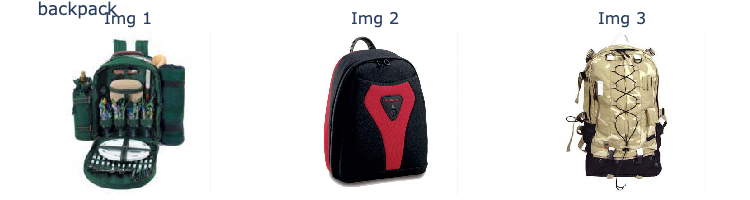

bike


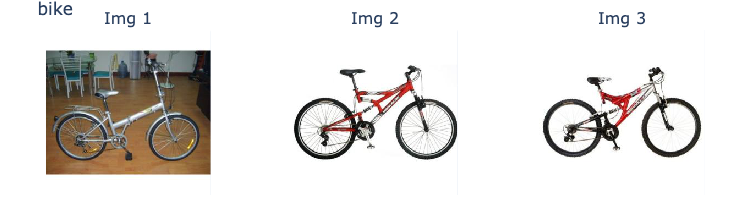

calculator


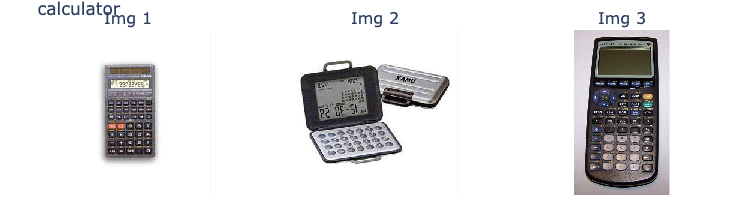

headphones


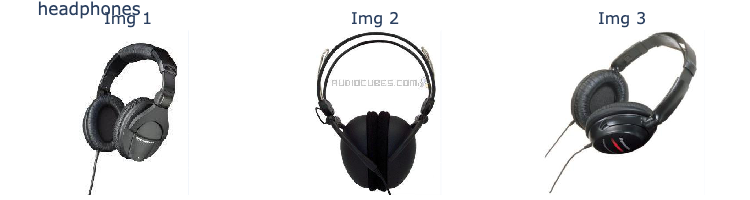

keyboard


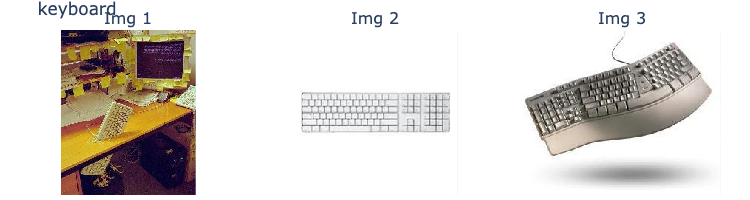

laptop


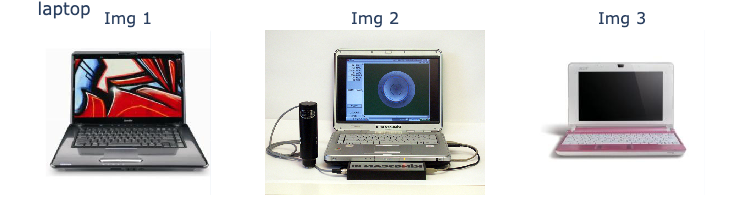

monitor


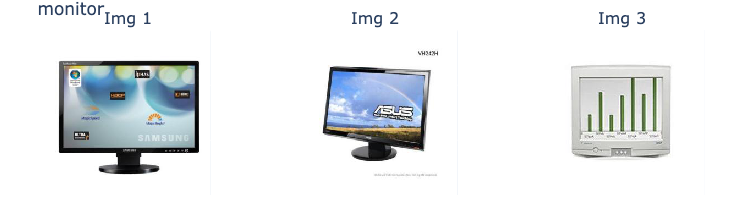

mouse


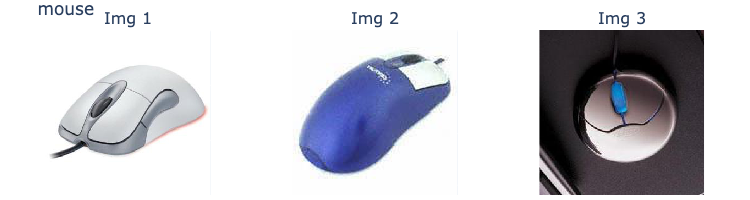

mug


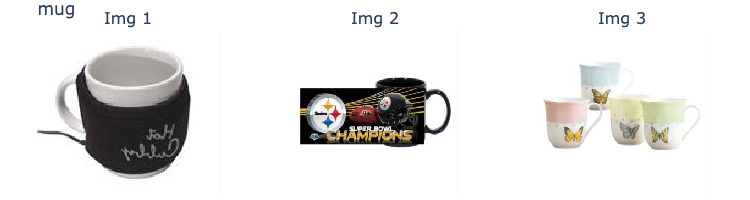

projector


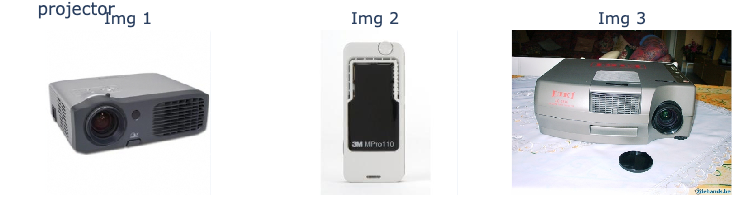

In [3]:
for label in np.unique(train[1]):
    print(label)
    sample_size = 3
    cur_label_idx = np.arange(len(train[1]))[train[1]==label]
    sample_idx = np.random.choice(cur_label_idx, sample_size)
    
    imgs = []
    for idx in sample_idx:
        imgs.append(train[3][idx])
    fig = create_image_fig(imgs)
    fig.update_layout(title=label)
    
    # unsure why, but subplots of images (tested using matplotlib as well)
    # lead to extremely large (>300mb) file sizes for this python notebook.
    # so, using ipython to display it instead
    fig.write_image(file="/Users/kennyalexlin/Desktop/MIDS/W281/W281-Domain-Adaptation-Final-Project/tmp_image.png", format="png", scale=1)
    display(Image('tmp_image.png'))

### Test Computing Orb Keypoints

In [7]:
sample_imgs = [train[3][100], train[3][200], train[3][300]]

In [8]:
create_image_fig(sample_imgs, images_per_row=1, titles=['Bicyle', 'Keyboard', 'Projector'])

In [9]:
for img in sample_imgs:
    orb = cv.ORB_create(nfeatures=500, edgeThreshold=100, scoreType=0)
    keypoints = orb.detect(img)
    keypoints, descriptors = orb.compute(img, keypoints)
    coords = [keypoint.pt for keypoint in keypoints]
    
    fig = px.imshow(img, width=300, height=300)
    fig.update_yaxes(visible=False, showticklabels=False)
    fig.update_xaxes(visible=False, showticklabels=False)
    fig.update_layout(margin=dict(l=5, r=5, t=30, b=5))
    scatter = go.Scatter(
        x=[x for x, y in coords], 
        y=[y for x, y in coords],
        mode='markers',
        marker=dict(color='red', size=5),
        name='Points'
    )
    fig.add_trace(scatter)
    fig.show()

In [ ]:
sample_imgs = [val[3][100], val[3][101], val[3][102]]
create_image_fig(sample_imgs, images_per_row=1, titles=['Headphones', 'Monitor', 'Laptop'])

In [128]:
for img in sample_imgs:
    orb = cv.ORB_create(nfeatures=500, edgeThreshold=100, scoreType=0)
    keypoints = orb.detect(img)
    keypoints, descriptors = orb.compute(img, keypoints)
    coords = [keypoint.pt for keypoint in keypoints]
    
    fig = px.imshow(img, width=300, height=300)
    fig.update_yaxes(visible=False, showticklabels=False)
    fig.update_xaxes(visible=False, showticklabels=False)
    fig.update_layout(margin=dict(l=5, r=5, t=30, b=5))
    scatter = go.Scatter(
        x=[x for x, y in coords], 
        y=[y for x, y in coords],
        mode='markers',
        marker=dict(color='red', size=5),
        name='Points'
    )
    fig.add_trace(scatter)
    fig.show()

### Compute Features for all objects in data

In [10]:
orb = cv.ORB_create(nfeatures=500, edgeThreshold=31, scoreType=0) # using default parameters

all_descriptors = []
all_coords = []
all_image_idxs = []
descriptor_labels = []
for idx1, img in enumerate(tqdm(train[3])):
    keypoints = orb.detect(img)
    keypoints, descriptors = orb.compute(img, keypoints)
    if descriptors is not None: # handle the case where there are no returned keypoints
        for idx2, descriptor in enumerate(descriptors):
            all_descriptors.append(descriptor.tolist())
            descriptor_labels.append(train[1][idx1])
            all_image_idxs.append(idx1)
            all_coords.append(keypoints[idx2].pt)
            
all_descriptors = np.array(all_descriptors)
descriptor_labels = np.array(descriptor_labels)

100%|██████████| 2081/2081 [00:06<00:00, 319.31it/s]


In [11]:
from sklearn.cluster import KMeans

kmeans = KMeans(random_state=88, n_clusters=100)
kmeans.fit(all_descriptors)

KMeans(n_clusters=100, random_state=88)

### Gut Check that this is Working

In [14]:
laptop_idx = descriptor_labels == 'laptop'
laptop_features = kmeans.labels_[laptop_idx]

projector_idx = descriptor_labels == 'projector'
projector_features = kmeans.labels_[projector_idx]

In [15]:
to_plot = pd.DataFrame({
    'label':np.concatenate((["laptop"] * len(laptop_features), ["projector"] * len(projector_features))), 
    'features':np.concatenate((laptop_features, projector_features))
})
px.histogram(
    to_plot,
    x = 'features',
    color = 'label',
    barmode = 'overlay',
    histnorm='probability density'
)

# Full Model Training and Hyperparameter Tuning (n clusters) Step

### Compute Descriptors on Train and Val Sets

In [189]:
def get_orb_features(
    imgs,
    nfeatures=500,
    edgeThreshold=31,
    scoreType=0,
    n_clusters=200,
    kmeans=None,
    add_count=True,
    tfidf=True
):
    desc = []
    desc_flat = []
    orb = cv.ORB_create(nfeatures=nfeatures, edgeThreshold=edgeThreshold, scoreType=scoreType)
    print("Getting ORB keypoints...")
    for idx, img in enumerate(tqdm(imgs)):
        # convert to grayscale only to reduce impact of differences in hue
        # try/except because some imgs are already in grayscale
        try:
            img = cv.cvtColor(img, cv.COLOR_BGR2GRAY) 
        except:
            pass
        keypoints = orb.detect(img)
        keypoints, descriptors = orb.compute(img, keypoints)
        to_add = []
        if descriptors is not None:
            to_add = descriptors.tolist()
        desc.append(to_add)
        desc_flat = desc_flat + to_add
    
    # if no kmeans is provided, fit a new one
    if kmeans is None:
        print(f"No kmeans was provided, so fitting a new one...")
        kmeans = KMeans(random_state=88, n_clusters=n_clusters)
        kmeans.fit(desc_flat)
        
    dense = [kmeans.predict(i) if len(i) else [] for i in desc]
    
    sparse = []
    for vw_dense in dense:
        vw_sparse = np.zeros(n_clusters)
        for vw in vw_dense:
            vw_sparse[vw] += 1
        sparse.append(vw_sparse)
        
    features = np.stack(sparse)
    num_keypoints = features.sum(axis=1).reshape(-1,1)
    
    if tfidf:
        transformer = TfidfTransformer()
        features = transformer.fit_transform(features).toarray()

    if add_count:
        features = np.concatenate([features,num_keypoints], axis=1)
    
    return features, kmeans

### Fit models

In [ ]:
y_train = train[1]
y_val = val[1]

In [192]:
# tfidf = False and add_count = False
scaler = StandardScaler()
X_train1, kmeans = get_orb_features(train[3], tfidf = False, add_count=False)
X_train1 = scaler.fit_transform(X_train1)

X_val1, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = False, add_count=False)
X_val1 = scaler.transform(X_val1)

Getting ORB keypoints...


100%|██████████| 2081/2081 [00:14<00:00, 142.22it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:02<00:00, 111.02it/s]


In [193]:
# tfidf = False and add_count = True
scaler = StandardScaler()
X_train2, kmeans = get_orb_features(train[3], kmeans=kmeans, tfidf = False, add_count=True)
X_train2 = scaler.fit_transform(X_train2)

X_val2, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = False, add_count=True)
X_val2 = scaler.transform(X_val2)

Getting ORB keypoints...


100%|██████████| 2081/2081 [00:14<00:00, 148.39it/s]


Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 130.89it/s]


In [202]:
# tfidf = True and add_count = False
scaler = StandardScaler() # dont actually need to scale but leaving it in for cleanliness
X_train3, kmeans = get_orb_features(train[3], kmeans=kmeans, tfidf = True, add_count=False)
X_train3 = scaler.fit_transform(X_train3)

X_val3, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = True, add_count=False)
X_val3 = scaler.transform(X_val3)

Getting ORB keypoints...


100%|██████████| 2081/2081 [00:14<00:00, 146.34it/s]


Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 151.73it/s]


In [201]:
# tfidf = True and add_count = False
# Testing WITHOUT scaling
X_train3_x, kmeans = get_orb_features(train[3], kmeans=kmeans, tfidf = True, add_count=False)

X_val3_x, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = True, add_count=False)

Getting ORB keypoints...


100%|██████████| 2081/2081 [00:13<00:00, 154.90it/s]


Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 127.98it/s]


In [195]:
# tfidf = True and add_count = True
scaler = StandardScaler()
X_train4, kmeans = get_orb_features(train[3], kmeans=kmeans, tfidf = True, add_count=True)
X_train4 = scaler.fit_transform(X_train4)

X_val4, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = True, add_count=True)
X_val4 = scaler.transform(X_val4)

Getting ORB keypoints...


100%|██████████| 2081/2081 [00:14<00:00, 144.21it/s]


Getting ORB keypoints...


100%|██████████| 226/226 [00:02<00:00, 88.30it/s] 


### Fit Models

Train Accuracy: 0.8726573762614128
Val Accuracy: 0.3008849557522124


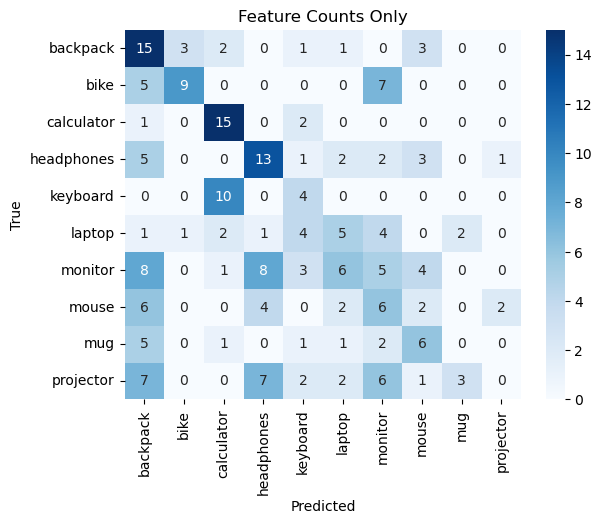

In [ ]:
model = svm.SVC(decision_function_shape='ovr')
model.fit(X_train1, y_train)
y_pred_train = model.predict(X_train1)
y_pred_val = model.predict(X_val1)
print(f"Train Accuracy: {accuracy_score(y_pred_train, y_train)}")
print(f"Val Accuracy: {accuracy_score(y_pred_val, y_val)}")
labels = np.sort(np.unique(y_train))
sns.heatmap(
    data = confusion_matrix(y_val, y_pred_val),
    annot = True,
    fmt = 'd',
    cmap = 'Blues',
    xticklabels = labels,
    yticklabels = labels,
)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Feature Counts Only')
plt.show()

Train Accuracy: 0.86977414704469
Val Accuracy: 0.29646017699115046


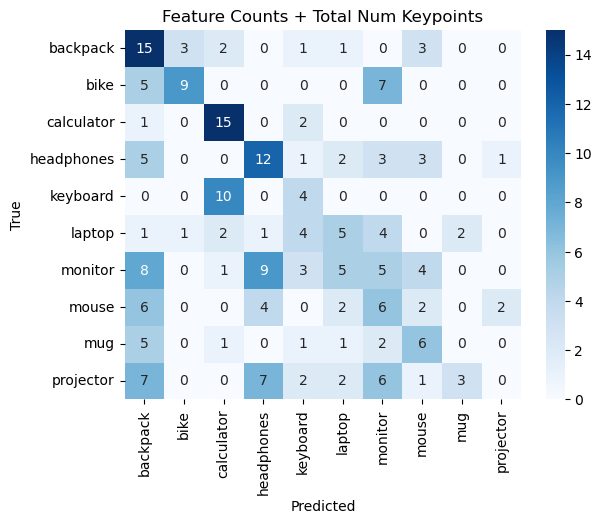

In [197]:
model = svm.SVC(decision_function_shape='ovr')
model.fit(X_train2, y_train)
y_pred_train = model.predict(X_train2)
y_pred_val = model.predict(X_val2)
print(f"Train Accuracy: {accuracy_score(y_pred_train, y_train)}")
print(f"Val Accuracy: {accuracy_score(y_pred_val, y_val)}")
labels = np.sort(np.unique(y_train))
sns.heatmap(
    data = confusion_matrix(y_val, y_pred_val),
    annot = True,
    fmt = 'd',
    cmap = 'Blues',
    xticklabels = labels,
    yticklabels = labels,
)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Feature Counts + Total Num Keypoints')
plt.show()

Train Accuracy: 0.8942815953868333
Val Accuracy: 0.30973451327433627


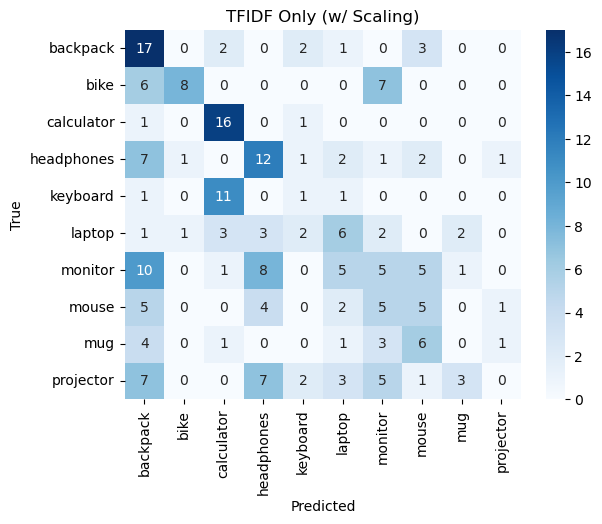

In [205]:
model = svm.SVC(decision_function_shape='ovr')
model.fit(X_train3, y_train)
y_pred_train = model.predict(X_train3)
y_pred_val = model.predict(X_val3)
print(f"Train Accuracy: {accuracy_score(y_pred_train, y_train)}")
print(f"Val Accuracy: {accuracy_score(y_pred_val, y_val)}")
labels = np.sort(np.unique(y_train))
sns.heatmap(
    data = confusion_matrix(y_val, y_pred_val),
    annot = True,
    fmt = 'd',
    cmap = 'Blues',
    xticklabels = labels,
    yticklabels = labels,
)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('TFIDF Only (w/ Scaling)')
plt.show()

Train Accuracy: 0.8755406054781355
Val Accuracy: 0.3274336283185841


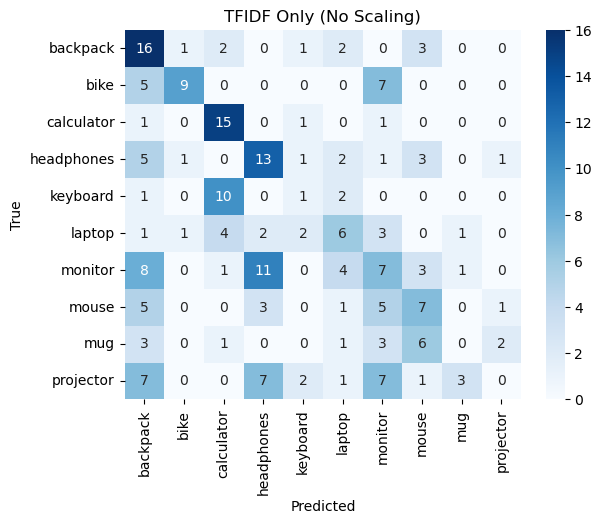

In [206]:
model = svm.SVC(decision_function_shape='ovr')
model.fit(X_train3_x, y_train)
y_pred_train = model.predict(X_train3_x)
y_pred_val = model.predict(X_val3_x)
print(f"Train Accuracy: {accuracy_score(y_pred_train, y_train)}")
print(f"Val Accuracy: {accuracy_score(y_pred_val, y_val)}")
labels = np.sort(np.unique(y_train))
sns.heatmap(
    data = confusion_matrix(y_val, y_pred_val),
    annot = True,
    fmt = 'd',
    cmap = 'Blues',
    xticklabels = labels,
    yticklabels = labels,
)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('TFIDF Only (No Scaling)')
plt.show()

Train Accuracy: 0.8990869774147044
Val Accuracy: 0.3185840707964602


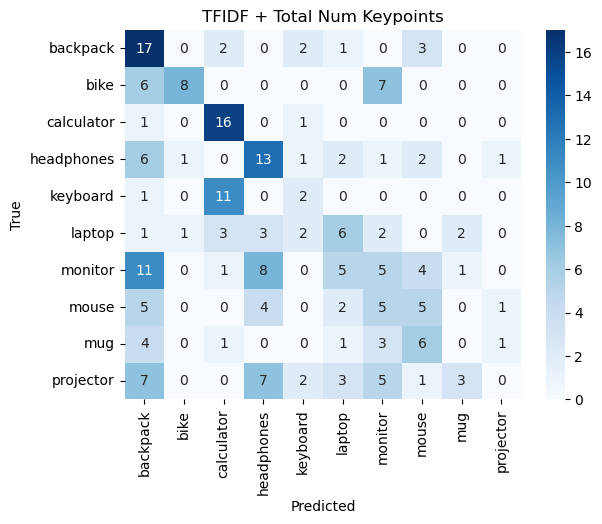

In [199]:
model = svm.SVC(decision_function_shape='ovr')
model.fit(X_train4, y_train)
y_pred_train = model.predict(X_train4)
y_pred_val = model.predict(X_val4)
print(f"Train Accuracy: {accuracy_score(y_pred_train, y_train)}")
print(f"Val Accuracy: {accuracy_score(y_pred_val, y_val)}")
labels = np.sort(np.unique(y_train))
sns.heatmap(
    data = confusion_matrix(y_val, y_pred_val),
    annot = True,
    fmt = 'd',
    cmap = 'Blues',
    xticklabels = labels,
    yticklabels = labels,
)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('TFIDF + Total Num Keypoints')
plt.show()

**Based on these tests, TFIDF features with no scaling works best**

### Determining Optimal Number of Clusters

In [209]:
to_test = [100, 150, 200, 300, 500]

In [210]:
train_acc = []
val_acc = []
for i in to_test:
    print(f'Working on {i} clusters...')
    X_train, kmeans = get_orb_features(train[3], tfidf = True, add_count=False, n_clusters = i)
    X_val, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = True, add_count=False, n_clusters = i)
    model = svm.SVC(decision_function_shape='ovr')
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_val = model.predict(X_val)
    train_acc.append(accuracy_score(y_pred_train, y_train))
    val_acc.append(accuracy_score(y_pred_val, y_val))

Working on 100 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:12<00:00, 162.63it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 127.22it/s]


Working on 150 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:15<00:00, 136.67it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 136.58it/s]


Working on 200 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:13<00:00, 149.19it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 159.13it/s]


Working on 300 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:13<00:00, 159.76it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 156.89it/s]


Working on 500 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:13<00:00, 150.03it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 154.25it/s]


In [222]:
to_plot = pd.DataFrame(data=[val_acc, to_test]).transpose()
to_plot.columns=['Val Acc', 'Num Clusters']

In [225]:
px.line(
    data_frame = to_plot,
    x='Num Clusters',
    y='Val Acc',
    title='Num Clusters vs Validation Accuracy'
)

### Determining Optimal Keypoint Parameters
Testing each hyperparameter independently due to resource constraints.

In [ ]:
edgeThresholds_to_test = [10, 15, 31, 50, 100]

train_acc = []
val_acc = []
for i in edgeThresholds_to_test:
    print(f'Working on {i} edgeThreshold...')
    X_train, kmeans = get_orb_features(train[3], tfidf = True, add_count=False, n_clusters = 150, edgeThreshold=i)
    X_val, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = True, add_count=False, n_clusters = 150, edgeThreshold=i)
    model = svm.SVC(decision_function_shape='ovr')
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_val = model.predict(X_val)
    train_acc.append(accuracy_score(y_pred_train, y_train))
    val_acc.append(accuracy_score(y_pred_val, y_val))

Working on 10 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:17<00:00, 117.67it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:02<00:00, 103.43it/s]


Working on 15 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:16<00:00, 124.50it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 145.84it/s]


Working on 31 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:13<00:00, 155.91it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 147.79it/s]


Working on 50 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:11<00:00, 186.25it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 134.33it/s]


Working on 100 clusters...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:04<00:00, 425.22it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:02<00:00, 111.87it/s]


In [233]:
to_plot = pd.DataFrame(data=[val_acc, train_acc, edgeThresholds_to_test]).transpose()
to_plot.columns=['Val Acc', 'Train Acc','Edge Threshold']

In [ ]:
px.line(
    data_frame = to_plot,
    x='Edge Threshold',
    y='Val Acc',
    title='EdgeThreshold vs Val Acc'
)

In [236]:
px.line(
    data_frame = to_plot,
    x='Edge Threshold',
    y='Train Acc',
    title='EdgeThreshold vs Train Acc'
)

In [241]:
nfeatures_to_test = [300, 400, 500, 700, 1000, 1500, 3000]

train_acc = []
val_acc = []
for i in nfeatures_to_test:
    print(f'Working on {i} nfeatures...')
    X_train, kmeans = get_orb_features(train[3], tfidf = True, add_count=False, n_clusters = 150, edgeThreshold=50, nfeatures=i)
    X_val, kmeans = get_orb_features(val[3], kmeans=kmeans, tfidf = True, add_count=False, n_clusters = 150, edgeThreshold=50, nfeatures=i)
    model = svm.SVC(decision_function_shape='ovr')
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_val = model.predict(X_val)
    train_acc.append(accuracy_score(y_pred_train, y_train))
    val_acc.append(accuracy_score(y_pred_val, y_val))

Working on 300 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:08<00:00, 259.92it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 154.32it/s]


Working on 400 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:08<00:00, 232.89it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 124.34it/s]


Working on 500 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:10<00:00, 203.33it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 149.49it/s]


Working on 700 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:13<00:00, 152.37it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 146.86it/s]


Working on 1000 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:16<00:00, 122.86it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:01<00:00, 143.64it/s]


Working on 1500 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:19<00:00, 105.53it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:02<00:00, 88.80it/s] 


Working on 3000 nfeatures...
Getting ORB keypoints...


100%|██████████| 2081/2081 [00:26<00:00, 78.34it/s]


No kmeans was provided, so fitting a new one...
Getting ORB keypoints...


100%|██████████| 226/226 [00:02<00:00, 107.16it/s]


In [242]:
to_plot = pd.DataFrame(data=[val_acc, train_acc, nfeatures_to_test]).transpose()
to_plot.columns=['Val Acc', 'Train Acc','nfeatures']

In [243]:
px.line(
    data_frame = to_plot,
    x='nfeatures',
    y='Val Acc',
    title='nfeaures vs Val Acc'
)

In [244]:
px.line(
    data_frame = to_plot,
    x='nfeatures',
    y='Train Acc',
    title='nfeaures vs Train Acc'
)

---

In [28]:
from sklearn.feature_extraction.text import CountVectorizer

In [29]:
X_train_tmp = pd.DataFrame(
    data = np.array([img_idxs_arr_train, desc_clust_train]).transpose(),
    columns = ['img_idx', 'vw']
)

X_train_tmp['vw_str'] = X_train_tmp['vw'].astype(str)
X_train_tmp = X_train_tmp.groupby(by='img_idx')['vw_str'].apply(lambda x: ' '.join(x)).reset_index()

In [38]:
vectorizer = CountVectorizer(vocabulary={str(i):str(i) for i in range(N_CLUSTERS)})
X_train_vw = vectorizer.fit_transform(X_train_tmp['vw_str'])

ValueError: Vocabulary of size 100 doesn't contain index 0.

In [35]:
pd.DataFrame(X_train_vw.toarray())

TypeError: DataFrame.__init__() got an unexpected keyword argument 'vocabulary'

In [ ]:
from sklearn.preprocessing import OneHotEncoder
desc_clust_train.

---

In [ ]:
from tqdm import tqdm

all_descriptors = []
all_coords = []
all_image_idxs = []
descriptor_labels = []
for idx1, img in enumerate(tqdm(train[3])):
    keypoints = orb.detect(img)
    keypoints, descriptors = orb.compute(img, keypoints)
    if descriptors is not None: # handle the case where there are no returned keypoints
        for idx2, descriptor in enumerate(descriptors):
            all_descriptors.append(descriptor.tolist())
            descriptor_labels.append(train[1][idx1])
            all_image_idxs.append(idx1)
            all_coords.append(keypoints[idx2].pt)
            
all_descriptors = np.array(all_descriptors)
descriptor_labels = np.array(descriptor_labels)